In [1]:
from PIL import Image
from PIL import ImageDraw
import pandas as pd
import gdal
import math
import numpy as np
import matplotlib.pyplot as plt
import cv2 as cv

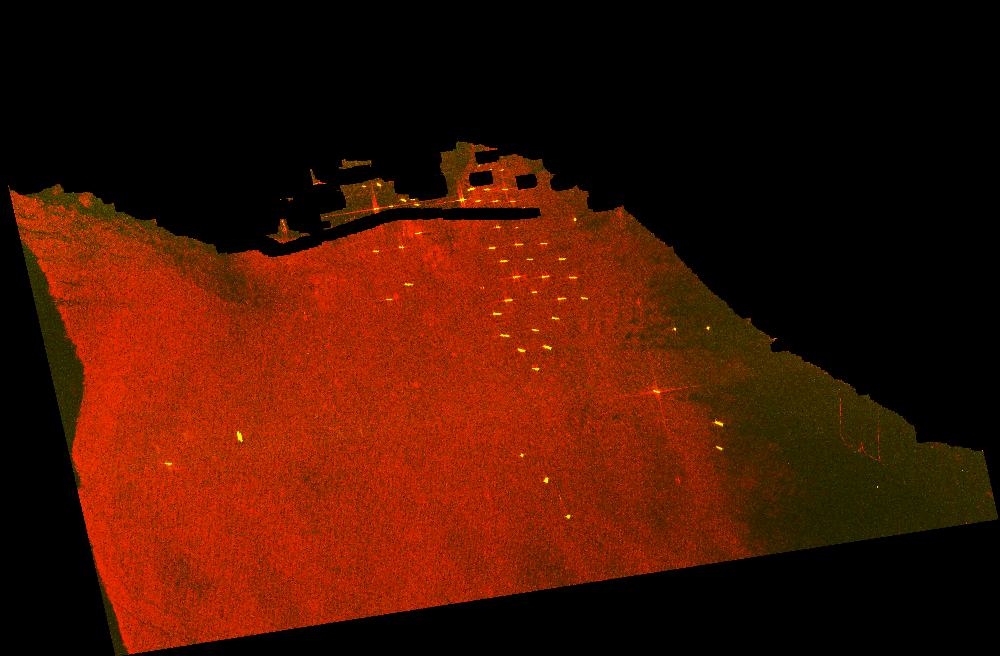

In [2]:
# im = Image.open("S1A_IW_GRDH_1SDV_20210106T015004_20210106T015033_036011_04381A_71E9.png")
im = Image.open("denoised_S1A_IW_GRDH_1SDV_20210106T015004_20210106T015033_036011_04381A_71E9.png")
im

In [3]:
im_data = pd.read_csv("interpolated_processed_AIS_2021_01_06.csv", index_col=0)
im_data

,MMSI,BaseDateTime,LAT,LON,SOG,COG,Heading,VesselName,IMO,CallSign,VesselType,Status,Length,Width,Draft,Cargo,TranscieverClass
0,311827000,2021-01-06 01:50:18.500,33.735010,-118.143113,0.1,0.8,261.0,NORWEGIAN JEWEL,IMO9304045,C6TX6,60.0,1.0,294.0,37.0,8.3,NaN,A
1,367369720,2021-01-06 01:50:18.500,33.735033,-118.159440,0.0,327.6,272.0,ALTA JUNE,IMO9552290,WDE5645,31.0,0.0,23.0,10.0,NaN,NaN,A
2,367655170,2021-01-06 01:50:18.500,33.723813,-118.280826,0.5,42.5,511.0,PACIFIC STAR,IMO0000000,WDH8150,34.0,NaN,22.0,8.0,NaN,NaN,B
3,367344710,2021-01-06 01:50:18.500,33.614810,-117.914550,0.0,34.9,25.0,SERENGETI,NaN,WDE3827,37.0,5.0,35.0,7.0,NaN,37.0,A
4,636019717,2021-01-06 01:50:18.500,33.677190,-118.210063,0.2,295.9,269.0,VOLANS,IMO9430777,D5VV2,71.0,1.0,265.0,32.0,11.5,71.0,A
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
315,338239156,2021-01-06 01:50:18.500,33.719223,-118.278425,0.0,360.0,511.0,CONTROLLED CHAOS,IMO0000000,NaN,37.0,NaN,17.0,5.0,NaN,NaN,B
316,368167990,2021-01-06 01:50:18.500,33.610220,-117.925263,0.0,50.8,511.0,IT'S ALL GOOD,IMO0000000,WDL8279,37.0,NaN,14.0,5.0,NaN,NaN,B
317,338310827,2021-01-06 01:50:18.500,33.721710,-118.070111,0.0,58.0,511.0,JAWS,IMO0000000,NaN,37.0,NaN,16.0,4.0,NaN,NaN,B
318,367450790,2021-01-06 01:50:18.500,33.620436,-117.926894,0.0,258.0,511.0,IMAGINE,NaN,WDF4347,37.0,NaN,17.0,5.0,NaN,NaN,B


In [4]:
def calculate_px_from_lon2(row, xOrigin, pixelWidth):
    return (row['LON'] - xOrigin) / pixelWidth

def calculate_px_from_lat2(row, yOrigin, pixelHeight):
    return (yOrigin - row['LAT']) / pixelHeight

In [5]:
def calculate_px_from_Length(row, meters_in_one_pixel):
    if math.isnan(row['Length']):
        return math.nan
    return row['Length'] / meters_in_one_pixel

def calculate_px_from_Width(row, meters_in_one_pixel):
    if math.isnan(row['Width']):
        return math.nan
    return row['Width'] / meters_in_one_pixel

In [6]:
def calculate_Length_ratio(row, image_height):
    if math.isnan(row['Length_px']) or row['Length_px'] == 0:
        return math.nan
    return image_height / row['Length_px']

def calculate_Width_ratio(row, image_width):
    if math.isnan(row['Width_px']) or row['Width_px'] == 0:
        return math.nan
    return image_width / row['Width_px']

In [7]:
in_ds = gdal.Open("S1A_IW_GRDH_1SDV_20210106T015004_20210106T015033_036011_04381A_71E9.png")
image_width = in_ds.RasterXSize
image_height = in_ds.RasterYSize
geo_transform = in_ds.GetGeoTransform()
xOrigin = geo_transform[0]  # NEEDED
yOrigin = geo_transform[3]  # NEEDED
pixelWidth = geo_transform[1]  # NEEDED
pixelHeight = -geo_transform[5]  # NEEDED
print(image_width, image_height,  xOrigin, yOrigin, pixelWidth, pixelHeight)

minx = geo_transform[0]  # minLON
miny = geo_transform[3] + image_width * geo_transform[4] + image_height * geo_transform[5]  # minLAT
maxx = geo_transform[0] + image_width * geo_transform[1] + image_height * geo_transform[2]  # maxLON
maxy = geo_transform[3]  # maxLAT

condition1 = (im_data.LAT > miny) & (im_data.LAT < maxy)
# condition for latitude: between -157.0894 and -154.4233
condition2 = (im_data.LON > minx) & (im_data.LON < maxx)
# final dataframe
target_area = im_data[condition1 & condition2].copy().reset_index(drop=True)
im_data = target_area

# 1 pixel is about 11.5 meters
METERS_IN_ONE_PIXEL = 11.5
for _, row in im_data.iterrows():
    im_data['LONpx_X2'] = im_data.apply(
        lambda row: calculate_px_from_lon2(row, xOrigin, pixelWidth), axis=1)
    im_data['LATpx_Y2'] = im_data.apply(
        lambda row: calculate_px_from_lat2(row, yOrigin, pixelHeight), axis=1)
    im_data['Length_px'] = im_data.apply(
        lambda row: calculate_px_from_Length(row, METERS_IN_ONE_PIXEL), axis=1)
    im_data['Width_px'] = im_data.apply(
        lambda row: calculate_px_from_Width(row, METERS_IN_ONE_PIXEL), axis=1)
#     im_data['Length_px_ratio'] = im_data.apply(
#         lambda row: calculate_Length_ratio(row, image_height), axis=1)
#     im_data['Width_px_ratio'] = im_data.apply(
#         lambda row: calculate_Width_ratio(row, image_width), axis=1)

5813 3814 -118.41420082828058 33.833581925625644 8.983152841195215e-05 8.983152841195215e-05


In [8]:
im_data#.head(20)

,MMSI,BaseDateTime,LAT,LON,SOG,COG,Heading,VesselName,IMO,CallSign,...,Status,Length,Width,Draft,Cargo,TranscieverClass,LONpx_X2,LATpx_Y2,Length_px,Width_px
0,311827000,2021-01-06 01:50:18.500,33.735010,-118.143113,0.1,0.8,261.0,NORWEGIAN JEWEL,IMO9304045,C6TX6,...,1.0,294.0,37.0,8.3,NaN,A,3017.732190,1097.297657,25.565217,3.217391
1,367369720,2021-01-06 01:50:18.500,33.735033,-118.159440,0.0,327.6,272.0,ALTA JUNE,IMO9552290,WDE5645,...,0.0,23.0,10.0,NaN,NaN,A,2835.984568,1097.044658,2.000000,0.869565
2,367655170,2021-01-06 01:50:18.500,33.723813,-118.280826,0.5,42.5,511.0,PACIFIC STAR,IMO0000000,WDH8150,...,NaN,22.0,8.0,NaN,NaN,B,1484.716361,1221.939373,1.913043,0.695652
3,367344710,2021-01-06 01:50:18.500,33.614810,-117.914550,0.0,34.9,25.0,SERENGETI,NaN,WDE3827,...,5.0,35.0,7.0,NaN,37.0,A,5562.087578,2435.357936,3.043478,0.608696
4,636019717,2021-01-06 01:50:18.500,33.677190,-118.210063,0.2,295.9,269.0,VOLANS,IMO9430777,D5VV2,...,1.0,265.0,32.0,11.5,71.0,A,2272.449683,1740.946952,23.043478,2.782609
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
314,338239156,2021-01-06 01:50:18.500,33.719223,-118.278425,0.0,360.0,511.0,CONTROLLED CHAOS,IMO0000000,NaN,...,NaN,17.0,5.0,NaN,NaN,B,1511.445239,1273.036938,1.478261,0.434783
315,368167990,2021-01-06 01:50:18.500,33.610220,-117.925263,0.0,50.8,511.0,IT'S ALL GOOD,IMO0000000,WDL8279,...,NaN,14.0,5.0,NaN,NaN,B,5442.832757,2486.453582,1.217391,0.434783
316,338310827,2021-01-06 01:50:18.500,33.721710,-118.070111,0.0,58.0,511.0,JAWS,IMO0000000,NaN,...,NaN,16.0,4.0,NaN,NaN,B,3830.387132,1245.352579,1.391304,0.347826
317,367450790,2021-01-06 01:50:18.500,33.620436,-117.926894,0.0,258.0,511.0,IMAGINE,NaN,WDF4347,...,NaN,17.0,5.0,NaN,NaN,B,5424.669604,2372.734785,1.478261,0.434783


In [9]:
# BAD SOLUTION
# im_data_no_nans = im_data.dropna().reset_index(drop=True)
# im_data_no_nans

In [179]:
def getRed(R): return '#%02x%02x%02x' #(R,0,0)
def getGreen(G): return '#%02x%02x%02x' #(0,G,0)
def getBlue(B):return '#%02x%02x%02x' #(0,0,B)

5813 3814
31.783333333333335 48.44166666666667

---------------------
NEW PICTURE
Ship center current coordinates: (3017.732189795386, 1097.2976567158862)
Ship left upper corner current coordinates: (2957.732189795386, 1037.2976567158862)
Ship right lower current coordinates: (3077.732189795386, 1157.2976567158862)
Cropped image size: (120, 120)


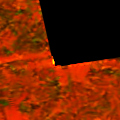

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Ship Length: (294.0 m), Width: (37.0 m)
50 50


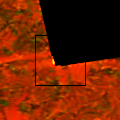

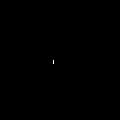

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


0      0
1      0
2      0
3      0
4      0
      ..
115    0
116    0
117    0
118    0
119    0
Length: 120, dtype: int32

Maximum x-axis sum: 1
Maximum x-axis pixel: from 60 to 63
Maximum x-axis pixel: 60
Center x-axis pixel: 62


0      0
1      0
2      0
3      0
4      0
      ..
115    0
116    0
117    0
118    0
119    0
Length: 120, dtype: int32

Maximum y-axis sum: 4
Maximum x-axis pixel: from 53 to 53
Maximum x-axis pixel: 53
Center x-axis pixel: 53
Maximum y-axis pixel: 53
Ship center current coordinates: (62, 53)


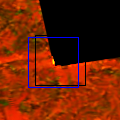

Ship center current coordinates: (53, 62)


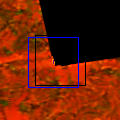

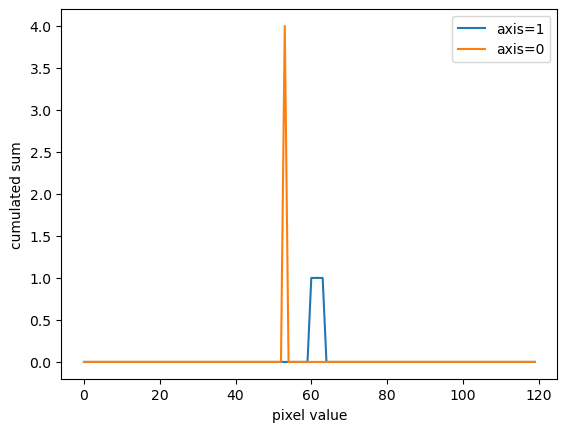

---------------------
NEW PICTURE
Ship center current coordinates: (2835.9845678266897, 1097.0446578732378)
Ship left upper corner current coordinates: (2775.9845678266897, 1037.0446578732378)
Ship right lower current coordinates: (2895.9845678266897, 1157.0446578732378)
Cropped image size: (120, 120)


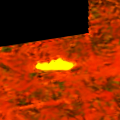

Ship center current coordinates: (60.0, 60.0)
RGB = (254, 252, 0)
Ship Length: (23.0 m), Width: (10.0 m)
50 50


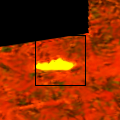

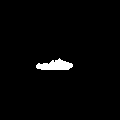

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


0      0
1      0
2      0
3      0
4      0
      ..
115    0
116    0
117    0
118    0
119    0
Length: 120, dtype: int32

Maximum x-axis sum: 37
Maximum x-axis pixel: from 58 to 69
Maximum x-axis pixel: 65
Center x-axis pixel: 64


0      0
1      0
2      0
3      0
4      0
      ..
115    0
116    0
117    0
118    0
119    0
Length: 120, dtype: int32

Maximum y-axis sum: 12
Maximum x-axis pixel: from 36 to 72
Maximum x-axis pixel: 59
Center x-axis pixel: 54
Maximum y-axis pixel: 59
Ship center current coordinates: (64, 54)


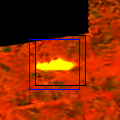

Ship center current coordinates: (54, 64)


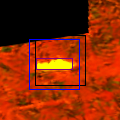

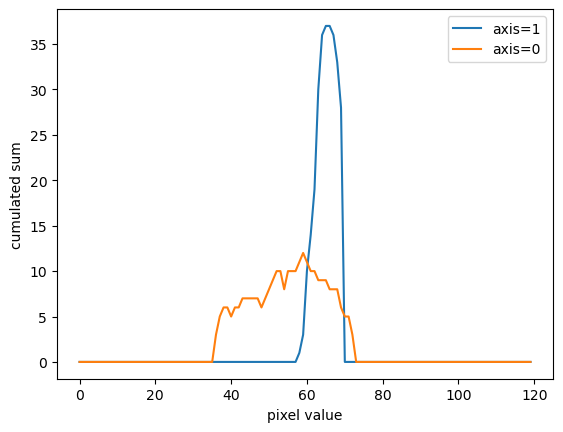

---------------------
NEW PICTURE
Ship center current coordinates: (1484.7163612159547, 1221.9393727233996)
Ship left upper corner current coordinates: (1424.7163612159547, 1161.9393727233996)
Ship right lower current coordinates: (1544.7163612159547, 1281.9393727233996)
Cropped image size: (120, 120)


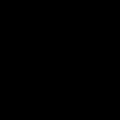

Ship center current coordinates: (60.0, 60.0)
RGB = (0, 0, 0)
Ship Length: (22.0 m), Width: (8.0 m)
50 50


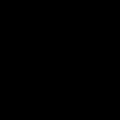

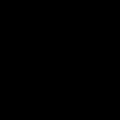

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


0      0
1      0
2      0
3      0
4      0
      ..
115    0
116    0
117    0
118    0
119    0
Length: 120, dtype: int32

Maximum x-axis sum: 0


IndexError: index 0 is out of bounds for axis 0 with size 0

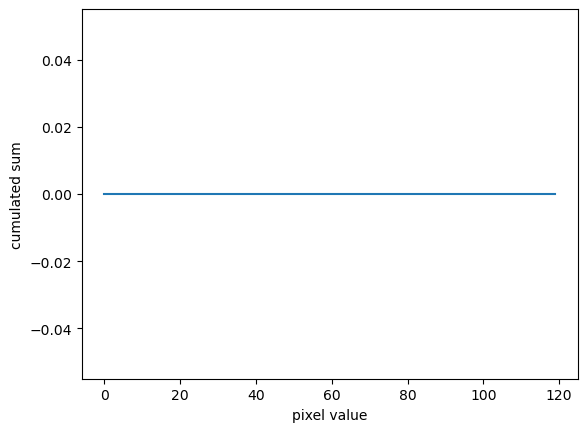

In [15]:
CHOSEN_SLICING_SIZE_PX = 60
NEW_IMAGE_LENGTH_RATIO_SCALER = np.longdouble(image_height / (2*CHOSEN_SLICING_SIZE_PX))
NEW_IMAGE_WIDTH_RATIO_SCALER = np.longdouble(image_width / (2*CHOSEN_SLICING_SIZE_PX))
print(image_width, image_height)
print(NEW_IMAGE_LENGTH_RATIO_SCALER, NEW_IMAGE_WIDTH_RATIO_SCALER)
print()
CROP_MARGIN_PX = 0 #-20
for index, row in im_data.iterrows():
    print("---------------------")
    print("NEW PICTURE")
    lon_x_px = row['LONpx_X2']
    lat_y_px = row['LATpx_Y2']
    print(f"Ship center current coordinates: {lon_x_px, lat_y_px}")
    left, upper = lon_x_px-CHOSEN_SLICING_SIZE_PX, lat_y_px-CHOSEN_SLICING_SIZE_PX
    right, lower = lon_x_px+CHOSEN_SLICING_SIZE_PX, lat_y_px+CHOSEN_SLICING_SIZE_PX
    print(f"Ship left upper corner current coordinates: {left, upper}")
    print(f"Ship right lower current coordinates: {right, lower}")
    im_cropped = im.crop((left, upper, right, lower))
    print(f"Cropped image size: {im_cropped.size}")
    display(im_cropped) #.show()
    center_x  = (right-left) / 2
    center_y  = (lower-upper) / 2
    print(f"Ship center current coordinates: {center_x, center_y}")
    r, g, b = im_cropped.getpixel((center_x, center_y))
    print(f"RGB = {r, g, b}")
#     if (r, g, b) == (0, 0, 0):
#         print("Black mask - not tagging")
#         print()
#         continue
    if math.isnan(row['Length']) or math.isnan(row['Width']): 
        print("Missing data about Length or Width - not tagging")
        print()
        continue
    elif row['Length'] < 20:
        print(f"Ship is too small to be seen ({row['Length']} m) - not tagging")
        print()
        continue
    print(f"Ship Length: ({row['Length']} m), Width: ({row['Width']} m)")
    
#     pixels = np.array(im_cropped)
#     width, height, channels = pixels.shape
#     print(width, height, channels)

#     actual_width = row['Length']
#     actual_units = 'meters'

#     (x1, y1) = ...
#     (x2, y2) = ...

#     pixel_distance = sqrt((x1 - x2) ** 2 + (y1 - y2) ** 2)

#     actual_distance = (pixel_distance / width) * actual_width

#     print(f"The distance between the two points is about {actual_distance:.3f} {actual_units}")
    
#     crop_size_x = row['Length_px'] * NEW_IMAGE_LENGTH_RATIO_SCALER 
#     crop_size_y = row['Width_px'] * NEW_IMAGE_WIDTH_RATIO_SCALER
    crop_size_x, crop_size_y = 50, 50
    print(crop_size_x, crop_size_y)
    
    left, upper = center_x - (crop_size_x/2) + CROP_MARGIN_PX, center_y - (crop_size_y/2) + CROP_MARGIN_PX
    right, lower = center_x + (crop_size_x/2) + CROP_MARGIN_PX, center_y + (crop_size_y/2) + CROP_MARGIN_PX
    dr = ImageDraw.Draw(im_cropped)
    dr.rectangle(((left, upper), (right, lower)), outline="black")
    #display(im_cropped)
    display(im_cropped)
    ############################
    #### TURN TO GRAYSCALE
    ############################
    threshold = 200 #200 is the best
    im_gray = im_cropped.convert('L')
    # Threshold
    im_gray = im_gray.point( lambda p: 255 if p > threshold else 0 )
    # To mono
    im_gray = im_gray.convert('1')
    #im_gray = im_cropped.convert('L')
    display(im_gray)
    #r, g, b = im_cropped.split()
    #print(r.histogram())
#     hst = im_gray.histogram()
#     print(hst)
    array = np.array(im_gray).astype(int)
    print(array)
    
    length_series = pd.Series(np.sum(array, axis=1))
    length_series.plot(label='axis=1', xlabel='pixel value', ylabel='cumulated sum')
    length_max = length_series.max()
    display(length_series)
    print(f"Maximum x-axis sum: {length_max}")
    length_max_pixel = length_series[length_series == length_max].index[0]
    length_max_pixel_first = length_series[length_series > 0].index[0]
    length_max_pixel_last = length_series[length_series > 0].index[-1]
    length_center_pixel = round((length_max_pixel_first + length_max_pixel_last) / 2)
    print(f"Maximum x-axis pixel: from {length_max_pixel_first} to {length_max_pixel_last}")
    print(f"Maximum x-axis pixel: {length_max_pixel}")
    print(f"Center x-axis pixel: {length_center_pixel}")
    
    width_series = pd.Series(np.sum(array, axis=0))
    width_series.plot(label='axis=0')
    width_max = width_series.max()
    display(width_series)
    print(f"Maximum y-axis sum: {width_max}")
    width_max_pixel = width_series[width_series == width_max].index[0]
    width_max_pixel_first = width_series[width_series > 0].index[0]
    width_max_pixel_last = width_series[width_series > 0].index[-1]
    width_center_pixel = round((width_max_pixel_first + width_max_pixel_last) / 2)
    print(f"Maximum x-axis pixel: from {width_max_pixel_first} to {width_max_pixel_last}")
    print(f"Maximum x-axis pixel: {width_max_pixel}")
    print(f"Center x-axis pixel: {width_center_pixel}")
    print(f"Maximum y-axis pixel: {width_max_pixel}")
    plt.legend()
    
    print(f"Ship center current coordinates: {length_center_pixel, width_center_pixel}")
    left, upper = width_center_pixel - (crop_size_x/2) + CROP_MARGIN_PX, length_center_pixel - (crop_size_y/2) + CROP_MARGIN_PX
    right, lower = width_center_pixel + (crop_size_x/2) + CROP_MARGIN_PX, length_center_pixel + (crop_size_y/2) + CROP_MARGIN_PX
    dr = ImageDraw.Draw(im_cropped)
    dr.rectangle(((left, upper), (right, lower)), outline="blue")
    #display(im_cropped)
    display(im_cropped)
    
    print(f"Ship center current coordinates: {width_center_pixel, length_center_pixel}")
    tagging_length = length_max_pixel_last - length_max_pixel_first
    tagging_width = width_max_pixel_last - width_max_pixel_first
    left, upper = width_center_pixel - (tagging_width/2) + CROP_MARGIN_PX, length_center_pixel - (tagging_length/2) + CROP_MARGIN_PX
    right, lower = width_center_pixel + (tagging_width/2) + CROP_MARGIN_PX, length_center_pixel + (tagging_length/2) + CROP_MARGIN_PX
    dr = ImageDraw.Draw(im_cropped)
    dr.rectangle(((left, upper), (right, lower)), outline="purple")
    #display(im_cropped)
    display(im_cropped)
    
    plt.show()
    
#     hst = im_gray.histogram()
#     print(hst)
#     pd.Series(hst).plot()
    
#     # Otsu's thresholding
#     ret2, th2 = cv.threshold(im_gray, 0, 255, cv.THRESH_BINARY + cv.THRESH_OTSU)
#     plt.imshow(ret2, 'gray')

    if index > 10:
        break


In [281]:
length_series[length_series > 0].index

Int64Index([58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69], dtype='int64')

0      0
1      0
2      0
3      0
4      0
      ..
115    0
116    0
117    0
118    0
119    0
Length: 120, dtype: int32

Maximum x-axis sum: 37
Maximum x-axis pixel: 65


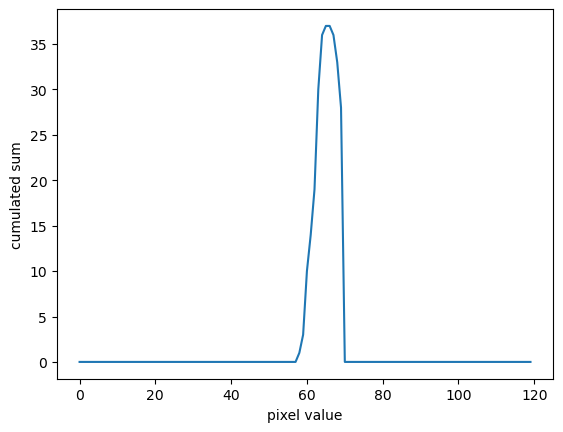

In [278]:
length_series = pd.Series(np.sum(array, axis=1))
length_series.plot(label='axis=1', xlabel='pixel value', ylabel='cumulated sum')
length_max = length_series.max()
display(length_series)
print(f"Maximum x-axis sum: {length_max}")
length_max_pixel = length_series[length_series == length_max].index[0]
print(f"Maximum x-axis pixel: {length_max_pixel}")

In [268]:
array[:1]

array([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
        1, 1, 0, 0, 0, 0, 0, 0, 0, 0]])

In [231]:
array.shape

(120, 120)

In [236]:
array[:][0:3]

array([[  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   8,  42,  47,  49,
         53,  61,  67,  63,  52,  61,  70,  71,  88,  77,  51,  52,  58,
         51,  46,  75,  92, 113, 114, 115, 105,  92,  90,  87,  80,  67,
         49,  42,  48],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,

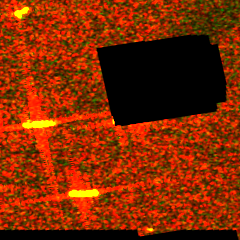

In [48]:
im_cropped

In [197]:
array

array([[  0,   0,   0, ...,  49,  42,  48],
       [  0,   0,   0, ...,  51,  32,  38],
       [  0,   0,   0, ...,  95,  66,  51],
       ...,
       [ 91,  92,  70, ...,  92,  50,  44],
       [101, 107,  56, ...,  90,  67,  53],
       [103, 105,  83, ...,  76,  64,  59]])

In [251]:
length_series[length_series == length_max].index[-1]

66

0      0.0
1      0.0
2      0.0
3      0.0
4      0.0
      ... 
115    0.0
116    0.0
117    0.0
118    0.0
119    0.0
Length: 120, dtype: float64

Maximum x-axis sum: 0.5
Maximum x-axis pixel: from 69 to 69


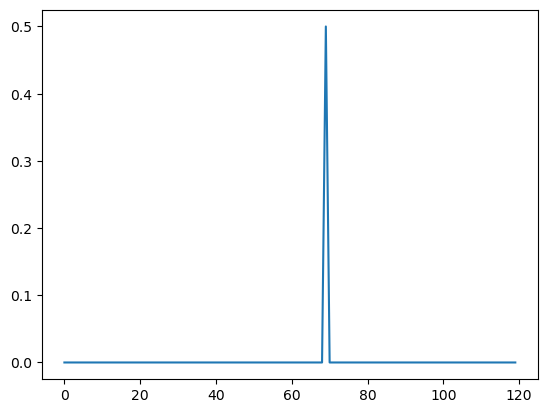

In [273]:
length_series = pd.Series(np.median(array, axis=1))
length_series.plot()
length_max = length_series.max()
display(length_series)
print(f"Maximum x-axis sum: {length_max}")
length_max_pixel_first = length_series[length_series == length_max].index[0]
length_max_pixel_last = length_series[length_series == length_max].index[-1]
print(f"Maximum x-axis pixel: from {length_max_pixel_first} to {length_max_pixel_last}")

0       2236
1       2210
2       2022
3       1833
4       1796
       ...  
115    10238
116    10111
117    10271
118    10365
119    10159
Length: 120, dtype: int32

Maximum x-axis sum: 15967
Maximum x-axis pixel: 65


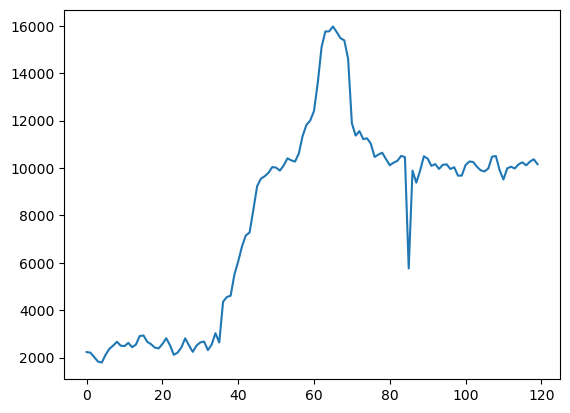

In [217]:
length_series = pd.Series(array.sum(axis=1))
length_series.plot()
length_max = length_series.max()
display(length_series)
print(f"Maximum x-axis sum: {length_max}")
length_max_pixel = length_series[length_series == length_max].index[0]
print(f"Maximum x-axis pixel: {length_max_pixel}")

0       6605
1       6671
2       6488
3       6705
4       6639
       ...  
115    10016
116    10273
117    10438
118    10292
119     9957
Length: 120, dtype: int32

Maximum y-axis sum: 10438
Maximum y-axis pixel: 117


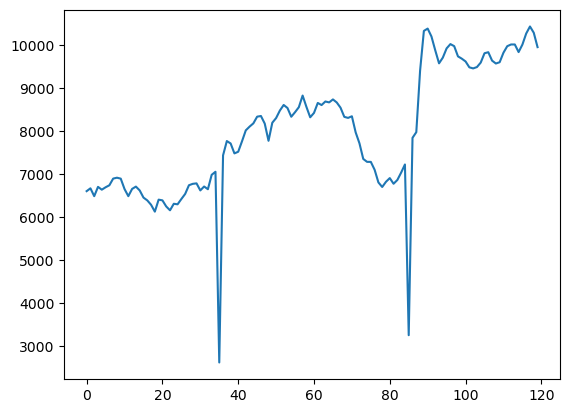

In [219]:
width_series = pd.Series(array.sum(axis=0))
width_series.plot()
width_max = width_series.max()
display(width_series)
print(f"Maximum y-axis sum: {width_max}")
width_max_pixel = width_series[width_series == width_max].index[0]
print(f"Maximum y-axis pixel: {width_max_pixel}")

<AxesSubplot:>

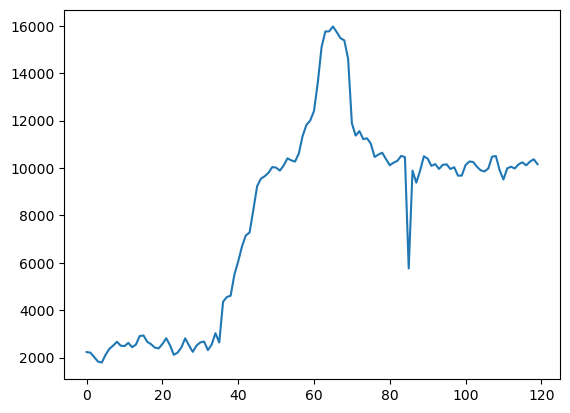

In [198]:
pd.Series(array.sum(axis=1)).plot()

<AxesSubplot:>

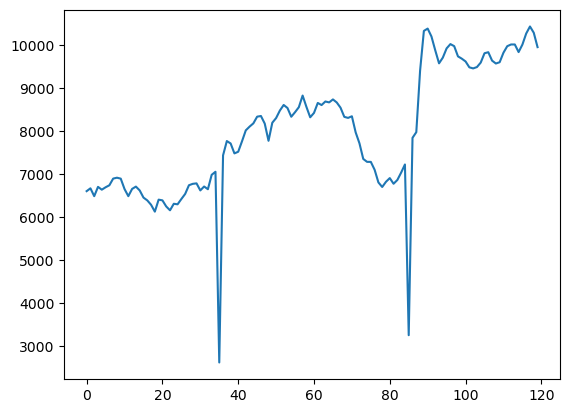

In [200]:
pd.Series(array.sum(axis=0)).plot()

<AxesSubplot:>

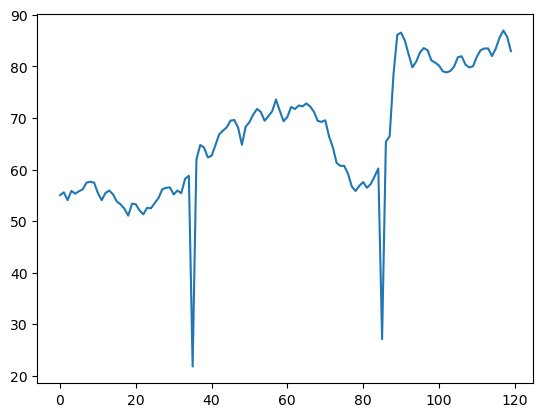

In [202]:
pd.Series(array.mean(axis=0)).plot()

In [ ]:
    
    Red=hst[0:256] # indicates Red
    Green=hst[256:512] # indicated Green
    Blue=hst[512:768] # indicates Blue
    
    plt.figure(0) # plots a figure to display RED Histogram
    for i in range(0, 256):
        plt.bar(i, Red[i], color = getRed(i),alpha=0.3)
    
    plt.figure(1) # plots a figure to display GREEN Histogram
    for i in range(0, 256):
        plt.bar(i, Green[i], color = getGreen(i),alpha=0.3)
    
    plt.figure(2) # plots a figure to display BLUE Histogram
    for i in range(0, 256):
        plt.bar(i, Blue[i], color = getBlue(i),alpha=0.3)
    
    plt.show()

## Dorobek solution

In [32]:
with open('subset89.txt', 'r') as f:
    lines = f.read().strip().split('\n')

In [33]:
print(lines)

['1 0.31875 0.496875 0.15625 0.15625', '3 0.63125 0.228125 0.15625 0.15625']


In [7]:
for l in lines:

    break

In [11]:
from PIL import Image
from PIL import ImageDraw

In [34]:
x = int(float(lines[0].split(' ')[1])*320)
y = int(float(lines[0].split(' ')[2])*320)
im = Image.open("subset89.png")
# im = im.convert('1')
CROP_SIZE = 15
dr = ImageDraw.Draw(im)
dr.rectangle(((x-CROP_SIZE, y-CROP_SIZE), (x+CROP_SIZE, y+CROP_SIZE)), outline="black")
im_cropped = im.crop((x-CROP_SIZE, y-CROP_SIZE, x+CROP_SIZE, y+CROP_SIZE))
im_cropped

In [35]:
x, y

(102, 159)

In [36]:
dr

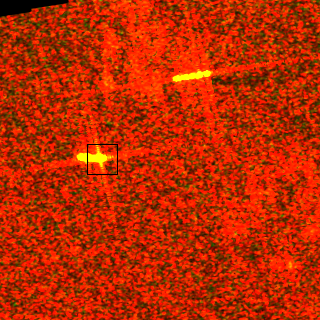

In [18]:
im

In [17]:
array = np.array(im_cropped).astype(int)
array

array([[[  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0],
        ...,
        [  0,   0,   0],
        [  0,   0,   0],
        [  0,   0,   0]],

       [[  0,   0,   0],
        [145,  59,   0],
        [255,  60,   0],
        ...,
        [207,  59,   0],
        [162,  42,   0],
        [140,  31,   0]],

       [[  0,   0,   0],
        [132,  55,   0],
        [255,  30,   1],
        ...,
        [166,  44,   0],
        [120,  28,   0],
        [ 85,  21,   0]],

       ...,

       [[  0,   0,   0],
        [255,  36,   0],
        [255,  49,   1],
        ...,
        [170,  69,   0],
        [127,  61,   0],
        [122,  51,   0]],

       [[  0,   0,   0],
        [223,  31,   0],
        [255,  39,   0],
        ...,
        [ 85,  62,   0],
        [ 70,  54,   0],
        [154,  60,   0]],

       [[  0,   0,   0],
        [255,  40,   0],
        [255,  64,   0],
        ...,
        [104,  70,   0],
        [125,  60,   0],
        [230,  48,   0]]

In [13]:
import numpy as np

im_cropped_gray = im_cropped.convert('1')
im_cropped_gray
array = np.array(im_cropped_gray).astype(int)
array

array([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
        0, 0, 0, 0, 0, 0, 0, 0],
       [0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0,
        1, 0, 1, 0, 0, 1, 0, 0],
       [0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0,
        0, 1, 0, 0, 1, 0, 0, 0],
       [0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1,
        0, 0, 0, 1, 0, 0, 1, 0],
       [0, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0,
        0, 1, 0, 0, 0, 1, 0, 0],
       [0, 0, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0,
        0, 0, 0, 1, 0, 0, 1, 0],
       [0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0,
        1, 0, 0, 0, 1, 0, 1, 0],
       [0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0,
        0, 0, 1, 0, 1, 0, 0, 1],
       [0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0,
        1, 0, 1, 0, 0, 1, 0, 0],
       [0, 1, 1, 0, 1, 0, 0, 1, 0, 1,

In [14]:
im_cropped_gray

<AxesSubplot:>

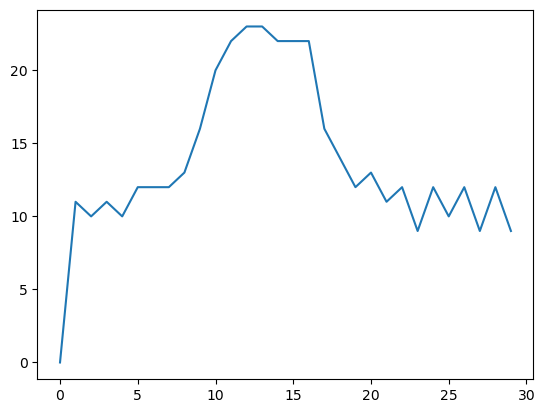

In [15]:
import pandas as pd


pd.Series(array.sum(axis=1)).plot()

<AxesSubplot:>

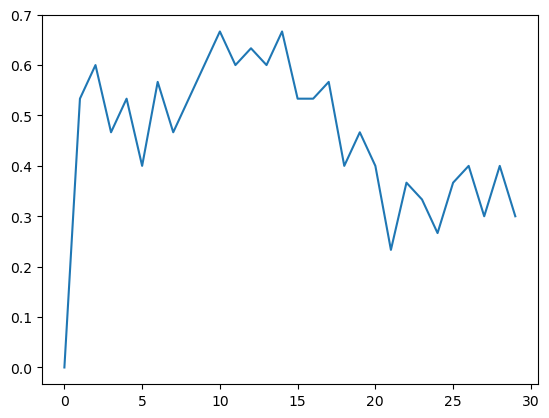

In [16]:
pd.Series(array.mean(axis=0)).plot()